In [1]:
import json
import pandas as pd
import numpy as np
import itertools
import matplotlib.pyplot as plt
import matplotlib.patches as patches


from PIL import Image
from pycocotools.coco import COCO



<h1>Helper variables</h1>

In [2]:
annotation_base_path = "./annotations"
images_base_path = "./train2017"

<h1>Helper Functions</h1>

In [3]:
def load_annotations(path):
    file = open(path)
    return json.load(file)

In [4]:
def show_category_metadata(categories, category_id):
    for cat in categories:
        if cat['id'] == category_id:
            return cat

In [5]:
def show_annotation_metadata(annotations, annotation_id):
    for ann in annotations:
        if ann['id'] == annotation_id:
            return ann

In [6]:
def draw_bounding_box(annotation, ax):
    for annotation_key, annotation_value in annotation.items():
                        if annotation_key == 'bbox':
                            box = annotation_value
                            bb = patches.Rectangle((box[0],box[1]), 
                                                   box[2],
                                                   box[3], 
                                                   linewidth=2, 
                                                   edgecolor="blue", 
                                                   facecolor="none")
                            ax.add_patch(bb)

In [7]:
def show_image(image_id, annotation_object: list = None, giraffe_only=False):
    image_id_string = str(image_id)
    image_name = f"{images_base_path}/{image_id_string.zfill(12)}.jpg"
    image = Image.open(image_name)

    fig, ax = plt.subplots()
    if annotation_object:
        for annotation in annotation_object:
            if giraffe_only == True:
                if annotation['category_id'] == 25:
                    draw_bounding_box(annotation, ax)
            else:
                draw_bounding_box(annotation, ax)
        
    
    
    ax.imshow(image, interpolation='nearest')
    plt.show()

<h1>Annotations: instances</h1>

In [8]:
instance_annotations = load_annotations(f"{annotation_base_path}/instances_train2017.json")

<h1>Exploring Annotation Object</h1>

In [9]:
instance_annotations.keys()

dict_keys(['info', 'licenses', 'images', 'annotations', 'categories'])

<h1>Load annotations</h1>

In [10]:
annotations = instance_annotations['annotations']
print(f"Number of annotations: {len(annotations)}")
annotations[0]

Number of annotations: 860001


{'segmentation': [[239.97,
   260.24,
   222.04,
   270.49,
   199.84,
   253.41,
   213.5,
   227.79,
   259.62,
   200.46,
   274.13,
   202.17,
   277.55,
   210.71,
   249.37,
   253.41,
   237.41,
   264.51,
   242.54,
   261.95,
   228.87,
   271.34]],
 'area': 2765.1486500000005,
 'iscrowd': 0,
 'image_id': 558840,
 'bbox': [199.84, 200.46, 77.71, 70.88],
 'category_id': 58,
 'id': 156}

<h1>Load categories into variable</h1>

In [11]:
categories = instance_annotations['categories']
len(categories)

for cat in categories:
    print(cat)

{'supercategory': 'person', 'id': 1, 'name': 'person'}
{'supercategory': 'vehicle', 'id': 2, 'name': 'bicycle'}
{'supercategory': 'vehicle', 'id': 3, 'name': 'car'}
{'supercategory': 'vehicle', 'id': 4, 'name': 'motorcycle'}
{'supercategory': 'vehicle', 'id': 5, 'name': 'airplane'}
{'supercategory': 'vehicle', 'id': 6, 'name': 'bus'}
{'supercategory': 'vehicle', 'id': 7, 'name': 'train'}
{'supercategory': 'vehicle', 'id': 8, 'name': 'truck'}
{'supercategory': 'vehicle', 'id': 9, 'name': 'boat'}
{'supercategory': 'outdoor', 'id': 10, 'name': 'traffic light'}
{'supercategory': 'outdoor', 'id': 11, 'name': 'fire hydrant'}
{'supercategory': 'outdoor', 'id': 13, 'name': 'stop sign'}
{'supercategory': 'outdoor', 'id': 14, 'name': 'parking meter'}
{'supercategory': 'outdoor', 'id': 15, 'name': 'bench'}
{'supercategory': 'animal', 'id': 16, 'name': 'bird'}
{'supercategory': 'animal', 'id': 17, 'name': 'cat'}
{'supercategory': 'animal', 'id': 18, 'name': 'dog'}
{'supercategory': 'animal', 'id':

<h1>Images object<h1>

In [12]:
images = instance_annotations['images']
images[2]


{'license': 3,
 'file_name': '000000184613.jpg',
 'coco_url': 'http://images.cocodataset.org/train2017/000000184613.jpg',
 'height': 336,
 'width': 500,
 'date_captured': '2013-11-14 12:36:29',
 'flickr_url': 'http://farm3.staticflickr.com/2169/2118578392_1193aa04a0_z.jpg',
 'id': 184613}

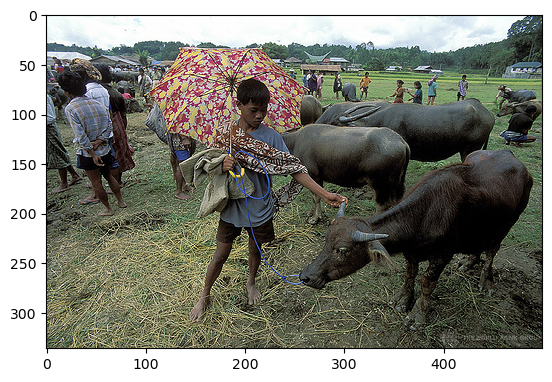

In [13]:
show_image(images[2]['id'])

<h1>Categories object</h1>

In [14]:
instance_annotations['categories'][0]

{'supercategory': 'person', 'id': 1, 'name': 'person'}

<h1>Annotations Object</h1>

In [15]:
annotations = instance_annotations['annotations']
annotations_zero = annotations[0]
annotations_zero

{'segmentation': [[239.97,
   260.24,
   222.04,
   270.49,
   199.84,
   253.41,
   213.5,
   227.79,
   259.62,
   200.46,
   274.13,
   202.17,
   277.55,
   210.71,
   249.37,
   253.41,
   237.41,
   264.51,
   242.54,
   261.95,
   228.87,
   271.34]],
 'area': 2765.1486500000005,
 'iscrowd': 0,
 'image_id': 558840,
 'bbox': [199.84, 200.46, 77.71, 70.88],
 'category_id': 58,
 'id': 156}

<h1>Load category information on above annotation data</h1>

In [16]:
show_category_metadata(categories, 58)

{'supercategory': 'food', 'id': 58, 'name': 'hot dog'}

<h1>Load image above</h1>

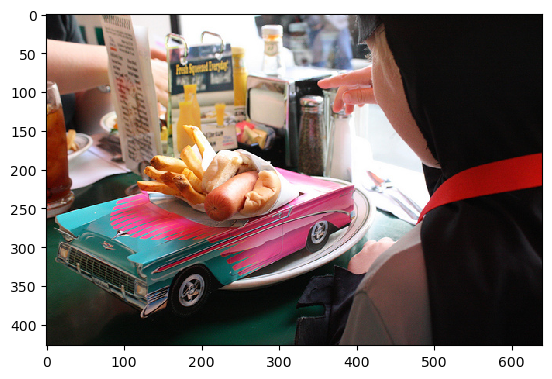

In [17]:
image_id = 558840
 
show_image(image_id)

<h1>Load image above with Bounding Boxes</h1>

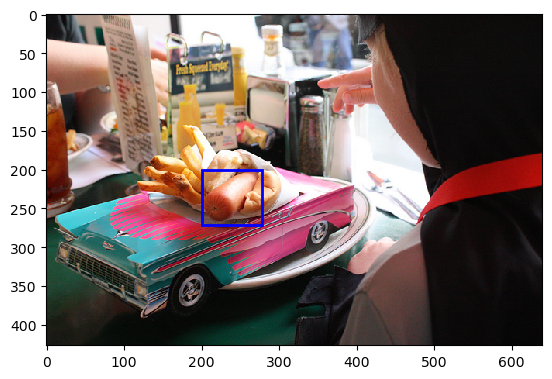

In [18]:
# Check bounding boxes match images for good practice. With less well-known datasets, this would be important
#... and would need to be done more thoroughly. 
show_image(image_id, annotation_object=[annotations_zero])

<h1>Use the COCO API to easily get images and Annotations</h1>

We can't guarantee that the image, annotation and categories object are aligned by index. This means to group the data together we'd need to write a fair bit of json / dictonary parsing code. 

Instead, we can use the COCO API.

In [19]:
coco_api = COCO(f"{annotation_base_path}/instances_train2017.json")

loading annotations into memory...
Done (t=40.35s)
creating index...
index created!


<h2>Use API to locate category IDs</h2>

In [20]:
giraffe_category_ids = coco_api.getCatIds(['giraffe'])
giraffe_category_ids

[25]

<h2>Use API to locate Image IDs for specific category</h2>

In [21]:
giraffe_image_ids = coco_api.getImgIds(catIds=giraffe_category_ids)
len(giraffe_image_ids)

2546

<h1>Showing first five images to validate giraffe category</h1>

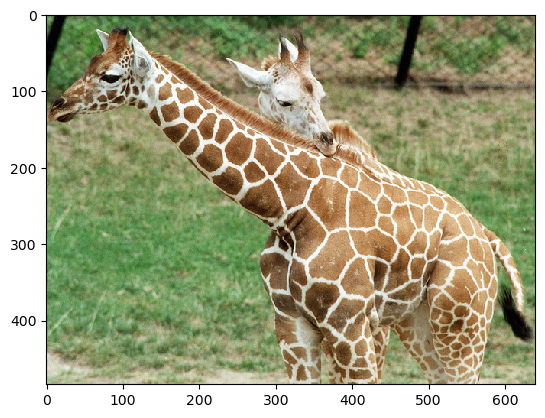

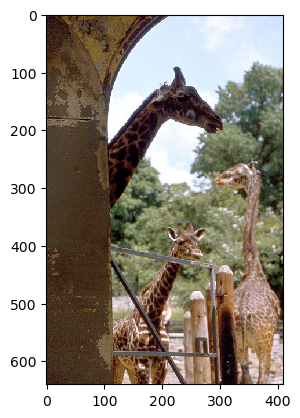

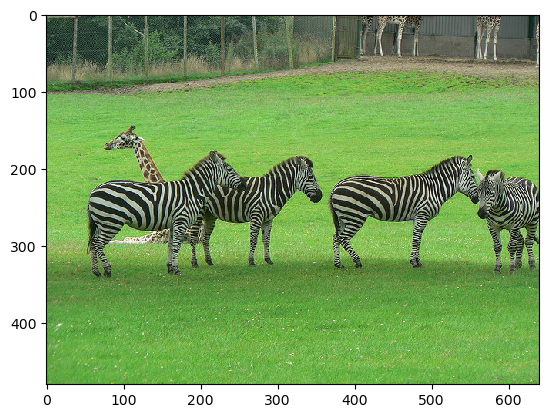

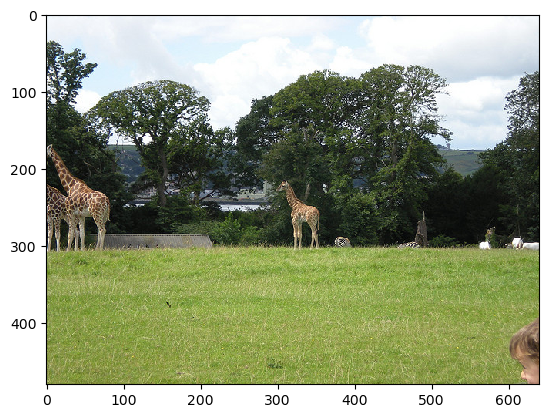

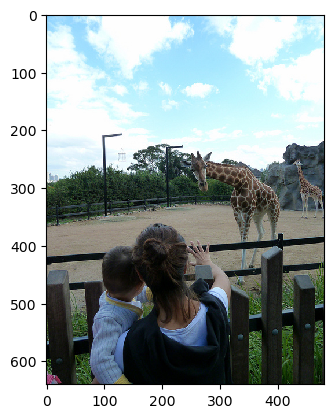

In [22]:
for id_ in giraffe_image_ids[:5]:
    show_image(id_)

<h2>Use API to locate annotations for specific category</h2>

In [23]:
giraffe_annotation_ids = coco_api.getAnnIds(imgIds=giraffe_image_ids, catIds=giraffe_category_ids)
len(giraffe_annotation_ids)

5131

<h2>Validating annotations with a single example</h2>


In [24]:
single_annotation = giraffe_annotation_ids[200]

In [25]:
show_annotation_metadata(annotations, single_annotation)

{'segmentation': [[204.74,
   330.47,
   208.42,
   302.85,
   209.04,
   283.21,
   206.58,
   273.38,
   207.81,
   258.04,
   200.44,
   229.19,
   194.92,
   225.51,
   182.64,
   224.28,
   193.08,
   207.1,
   199.83,
   207.71,
   209.65,
   212.62,
   209.04,
   220.6,
   215.79,
   244.54,
   226.22,
   244.54,
   226.84,
   254.97,
   245.25,
   266.63,
   249.55,
   300.39,
   256.91,
   334.15,
   253.84,
   335.99,
   248.32,
   314.51,
   242.8,
   286.89,
   238.5,
   298.55,
   242.18,
   312.05,
   238.5,
   342.13,
   227.45,
   339.67,
   221.31,
   289.96,
   215.79,
   288.12,
   208.42,
   334.15]],
 'area': 3242.8363499999996,
 'iscrowd': 0,
 'image_id': 524575,
 'bbox': [182.64, 207.1, 74.27, 135.03],
 'category_id': 25,
 'id': 594449}

In [26]:
show_category_metadata(categories, 25)

{'supercategory': 'animal', 'id': 25, 'name': 'giraffe'}

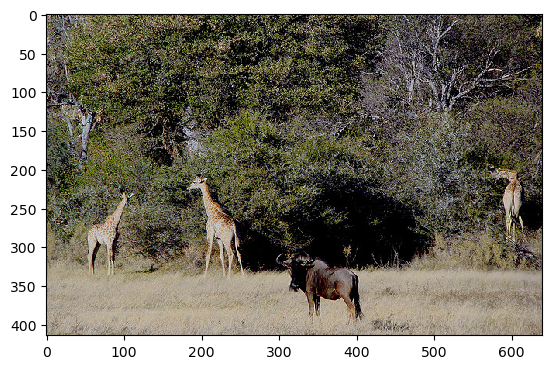

In [27]:
show_image(524575)

<h2>Category Exploration and checks</h2>

In [28]:
list_of_animal_objects = [
    "bird",
    "cat",
    "dog",
    "sheep",
    "cow",
    "elephant",
    "bear",
    "zebra",
    "giraffe"
]

<h3>Category IDs for all objects</h3>

In [29]:
animal_category_ids = coco_api.getCatIds(list_of_animal_objects)
animal_category_ids

[16, 17, 18, 20, 21, 22, 23, 24, 25]

In [30]:
if len(list_of_animal_objects) == len(animal_category_ids):
    print(True)

True


<h3>Image IDs for all objects</h3>

In [31]:
image_ids_matrix = [coco_api.getImgIds(catIds=id_) for id_ in animal_category_ids]
animal_image_ids = list(itertools.chain.from_iterable(image_ids_matrix))
print(len(animal_image_ids))

22798


<h3>Annotations for all objects</h3>

In [32]:
animal_annotations = coco_api.getAnnIds(imgIds=animal_image_ids, catIds=animal_category_ids)

<h3>Check that the annotation IDs and Image IDs match</h3>

In [33]:
example_annotation = show_annotation_metadata(annotations, animal_annotations[1057])
example_annotation

{'segmentation': [[249.19,
   216.21,
   250.1,
   216.21,
   252.85,
   213.46,
   254.68,
   207.96,
   248.27,
   202.46,
   257.43,
   201.55,
   257.43,
   196.97,
   260.18,
   184.14,
   269.34,
   177.73,
   272.09,
   174.06,
   284.0,
   181.39,
   284.0,
   192.39,
   284.0,
   200.63,
   289.5,
   202.46,
   291.33,
   203.38,
   292.25,
   205.21,
   294.99,
   218.04,
   294.99,
   220.79,
   294.99,
   238.19,
   294.99,
   253.77,
   293.16,
   262.93,
   287.66,
   264.76,
   280.34,
   261.1,
   277.59,
   250.1,
   272.09,
   243.69,
   265.68,
   234.53,
   254.68,
   222.62]],
 'area': 2423.4383500000004,
 'iscrowd': 0,
 'image_id': 328381,
 'bbox': [248.27, 174.06, 46.72, 90.7],
 'category_id': 16,
 'id': 39134}

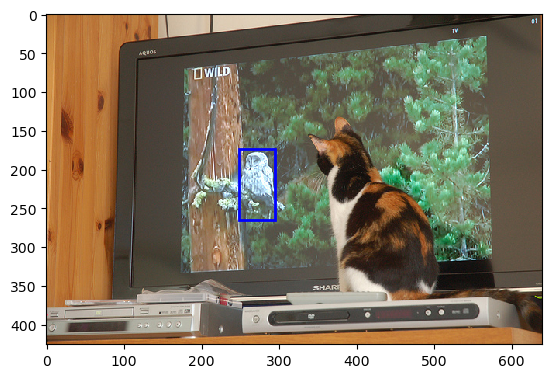

In [34]:
show_image(example_annotation['image_id'], annotation_object=[example_annotation])

<h2>Get Giraffe Data only</h2>

In [35]:
giraffe_subcategory_id = coco_api.getCatIds("giraffe")
print(f"Giraffe subcategory id: {giraffe_subcategory_id}")

Giraffe subcategory id: [25]


In [36]:
giraffe_image_ids_list = coco_api.getImgIds(catIds=25)
print(len(giraffe_image_ids_list))


2546


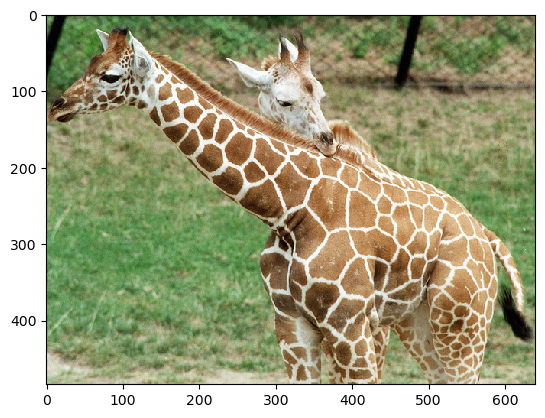

Annotation ids: [595089, 596459].

Annotation example: [{'segmentation': [[318.68, 478.56, 300.19, 387.2, 276.26, 321.94, 283.87, 268.65, 229.49, 228.4, 164.23, 167.5, 113.11, 116.38, 81.57, 127.25, 40.24, 128.34, 25.02, 142.48, 3.26, 139.22, 4.35, 123.99, 47.86, 78.31, 59.82, 54.38, 76.13, 44.59, 67.43, 17.4, 87.01, 17.4, 107.68, 18.49, 134.87, 44.59, 189.25, 70.7, 271.91, 131.6, 341.52, 160.97, 361.1, 184.9, 375.24, 187.07, 382.85, 178.37, 387.2, 169.67, 430.71, 180.55, 444.84, 200.13, 500.31, 224.05, 569.92, 271.91, 597.11, 292.58, 631.92, 354.57, 639.53, 412.22, 633.01, 432.88, 614.52, 426.36, 590.59, 375.24, 567.75, 476.39, 500.31, 476.39, 449.2, 410.04, 442.67, 474.21]], 'area': 110452.9536, 'iscrowd': 0, 'image_id': 57345, 'bbox': [3.26, 17.4, 636.27, 461.16], 'category_id': 25, 'id': 595089}, {'segmentation': [[280.57, 101.83, 274.62, 112.02, 281.42, 130.71, 312.84, 146.84, 360.41, 184.22, 378.24, 186.76, 381.64, 175.72, 392.68, 175.72, 439.4, 188.46, 425.81, 170.63, 395.23, 13

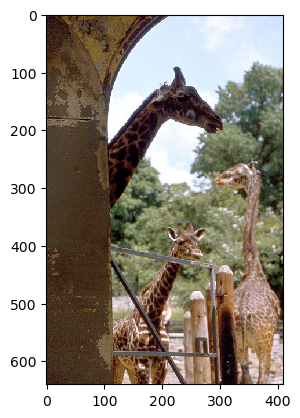

Annotation ids: [595305, 595329, 599246].

Annotation example: [{'segmentation': [[104.99, 225.8, 186.97, 136.63, 204.22, 123.69, 220.04, 122.25, 222.92, 96.36, 237.3, 100.67, 237.3, 126.56, 251.69, 130.88, 283.33, 162.52, 307.78, 199.91, 284.76, 212.85, 263.19, 195.6, 220.04, 182.65, 191.28, 207.1, 113.62, 337.98]], 'area': 14816.845949999999, 'iscrowd': 0, 'image_id': 507908, 'bbox': [104.99, 96.36, 202.79, 241.62], 'category_id': 25, 'id': 595305}, {'segmentation': [[116.76, 536.94, 152.79, 510.99, 207.57, 585.95, 113.87, 581.62, 121.08, 542.7], [121.08, 593.15, 116.76, 629.19, 134.05, 630.63, 139.82, 614.77, 148.47, 629.19, 203.24, 632.07, 210.45, 601.8, 204.68, 598.92], [213.33, 580.18, 206.13, 545.59, 213.33, 518.2, 207.57, 500.9, 232.07, 438.92, 207.57, 430.27, 164.32, 499.46, 213.33, 590.27], [214.77, 415.86, 221.98, 400.0, 209.01, 376.94, 207.57, 365.41, 226.31, 376.94, 226.31, 384.14, 232.07, 381.26, 227.75, 361.08, 240.72, 362.52, 239.28, 371.17, 249.37, 363.96, 258.02, 366.

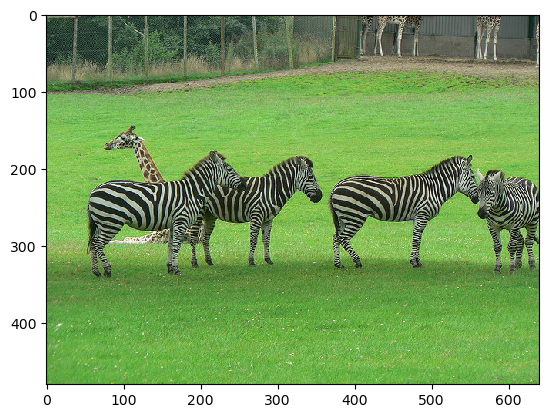

Annotation ids: [592319, 592864, 593787, 594041, 1414000, 1414588, 1414709].

Annotation example: [{'segmentation': [[369.98, 224.18, 412.04, 209.08, 483.24, 209.08, 528.54, 184.27, 546.88, 185.35, 557.66, 184.27, 553.35, 199.37, 563.06, 222.02, 565.21, 239.28, 556.58, 248.99, 550.11, 241.44, 532.85, 230.65, 513.44, 247.91, 500.49, 270.56, 495.1, 270.56, 483.24, 309.39, 487.55, 327.73, 473.53, 325.57, 471.37, 314.79, 476.76, 269.48, 428.22, 266.25, 420.67, 264.09, 395.87, 295.37, 409.89, 326.65, 406.65, 333.12, 401.26, 329.89, 384.0, 299.69, 384.0, 310.47, 387.24, 330.97, 375.37, 325.57, 372.13, 310.47, 372.13, 291.06, 375.37, 280.27, 366.74, 247.91]], 'area': 13332.755399999996, 'iscrowd': 0, 'image_id': 57350, 'bbox': [366.74, 184.27, 198.47, 148.85], 'category_id': 24, 'id': 592319}, {'segmentation': [[263.37, 270.94, 265.33, 307.53, 261.41, 329.74, 273.17, 327.13, 274.48, 299.69, 277.74, 282.7, 284.28, 327.13, 296.04, 325.17, 291.47, 308.84, 297.35, 269.63, 326.09, 228.47, 343.74, 

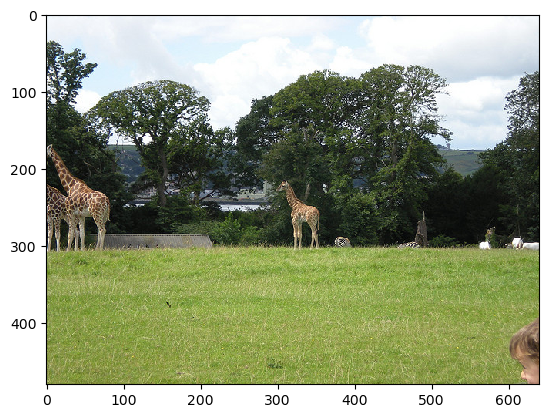

Annotation ids: [594365, 601186, 601307, 601472, 601567, 1238595, 1822561].

Annotation example: [{'segmentation': [[456.45, 302.56, 459.14, 298.64, 462.33, 297.9, 470.17, 296.68, 474.99, 295.61, 480.46, 296.59, 483.07, 297.57, 485.69, 301.09, 486.1, 302.15, 480.3, 304.11, 477.77, 305.25, 476.7, 309.33, 473.52, 311.38, 472.46, 310.89, 476.7, 304.11, 469.43, 303.45, 466.58, 303.45, 465.11, 305.74, 459.8, 307.62, 457.59, 304.35]], 'area': 221.2084000000004, 'iscrowd': 0, 'image_id': 327695, 'bbox': [456.45, 295.61, 29.65, 15.77], 'category_id': 24, 'id': 594365}, {'segmentation': [[7.45, 185.28, 23.71, 237.88, 39.01, 259.88, 48.58, 287.61, 50.49, 312.48, 52.4, 267.53, 60.05, 255.1, 60.05, 277.09, 64.84, 285.7, 65.79, 317.26, 65.79, 319.18, 75.36, 314.39, 79.18, 278.05, 88.75, 235.01, 58.14, 230.23, 56.23, 230.23, 32.32, 207.27, 15.1, 187.19, 7.45, 157.54, 3.62, 180.49, 3.62, 185.28]], 'area': 3803.2747999999992, 'iscrowd': 0, 'image_id': 327695, 'bbox': [3.62, 157.54, 85.13, 161.64], 'ca

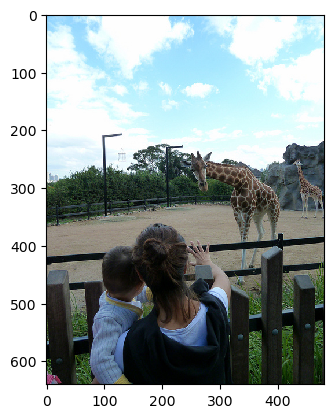

Annotation ids: [438819, 597424, 597500, 1714120].

Annotation example: [{'segmentation': [[136.94, 629.19, 118.2, 596.04, 123.96, 555.68, 134.05, 545.59, 170.09, 523.96, 181.62, 509.55, 181.62, 479.28, 172.97, 466.31, 157.12, 454.77, 152.79, 434.59, 152.79, 395.68, 162.88, 375.5, 171.53, 368.29, 194.59, 366.85, 214.77, 366.85, 239.28, 378.38, 247.93, 402.88, 246.49, 424.5, 240.72, 456.22, 243.6, 467.75, 244.42, 469.31, 254.05, 465.1, 263.08, 460.29, 267.29, 460.29, 276.32, 468.71, 282.94, 472.32, 288.35, 468.71, 291.36, 457.88, 288.35, 448.25, 286.55, 436.21, 273.31, 434.41, 266.69, 430.19, 256.46, 423.57, 249.23, 413.34, 249.83, 400.7, 249.83, 394.08, 258.26, 401.91, 266.08, 413.34, 260.67, 391.67, 263.08, 389.87, 266.69, 392.28, 273.91, 410.33, 275.71, 413.34, 279.33, 398.29, 281.73, 397.09, 283.54, 403.11, 282.94, 416.35, 286.55, 425.98, 297.38, 436.21, 316.04, 456.68, 317.85, 469.92, 317.85, 491.58, 313.03, 512.05, 313.63, 522.88, 316.64, 531.31, 317.85, 601.73, 319.65, 629.41, 14

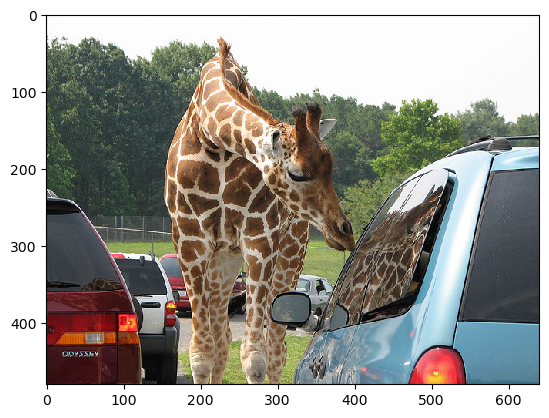

Annotation ids: [346865, 347525, 349689, 350850, 353665, 595473].

Annotation example: [{'segmentation': [[636.13, 156.37, 603.47, 157.9, 582.04, 156.88, 569.8, 156.88, 555.51, 163.51, 528.98, 172.18, 512.14, 190.04, 498.37, 195.14, 448.36, 228.82, 417.24, 274.74, 400.91, 295.66, 401.42, 304.33, 394.28, 310.97, 379.48, 344.64, 364.17, 373.73, 353.97, 392.09, 351.93, 393.62, 346.83, 386.99, 346.32, 375.26, 344.28, 364.54, 318.25, 359.44, 295.8, 370.66, 292.74, 395.16, 320.8, 404.34, 337.13, 415.05, 337.64, 438.02, 321.82, 464.55, 319.78, 480.0, 640.0, 480.0]], 'area': 77702.8149, 'iscrowd': 0, 'image_id': 540694, 'bbox': [292.74, 156.37, 347.26, 323.63], 'category_id': 3, 'id': 346865}, {'segmentation': [[1.08, 234.07, 45.3, 251.33, 105.71, 357.03, 126.2, 449.8, 131.6, 470.29, 5.39, 472.45, 1.08, 472.45]], 'area': 21669.94305, 'iscrowd': 0, 'image_id': 540694, 'bbox': [1.08, 234.07, 130.52, 238.38], 'category_id': 3, 'id': 347525}, {'segmentation': [[88.45, 311.4, 141.3, 310.32, 170.43,

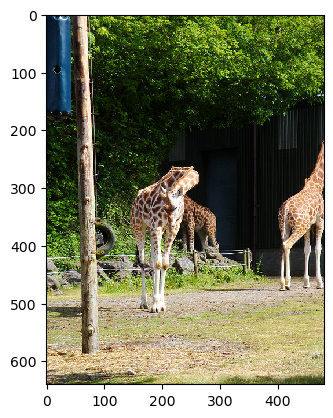

Annotation ids: [596056].

Annotation example: [{'segmentation': [[476.94, 464.07, 479.25, 472.14, 478.67, 475.6, 467.42, 475.03, 468.14, 464.07, 463.82, 458.73, 466.85, 453.54, 466.13, 429.02, 465.4, 414.17, 463.53, 411.29, 464.68, 401.62, 466.13, 399.03, 466.7, 373.65, 466.41, 361.24, 460.21, 364.56, 456.9, 367.59, 454.44, 383.16, 455.6, 396.0, 456.32, 402.2, 458.19, 406.23, 455.45, 415.89, 453.0, 439.39, 452.57, 451.94, 454.3, 455.4, 454.16, 462.1, 455.89, 473.06, 450.84, 475.51, 444.64, 475.51, 443.92, 469.6, 446.22, 463.4, 445.5, 458.79, 445.5, 453.59, 446.51, 449.27, 447.67, 427.92, 447.67, 415.67, 445.94, 412.78, 445.94, 403.12, 447.38, 400.09, 445.5, 381.78, 423.87, 403.7, 421.28, 411.92, 421.42, 444.57, 421.56, 452.22, 423.44, 455.68, 422.0, 461.95, 421.71, 474.49, 421.71, 477.81, 415.07, 477.52, 411.9, 468.87, 415.36, 466.42, 413.63, 457.91, 414.06, 429.21, 413.06, 420.41, 411.18, 454.59, 411.9, 457.83, 412.77, 460.86, 411.61, 468.93, 414.93, 479.03, 402.53, 477.73, 403.83, 4

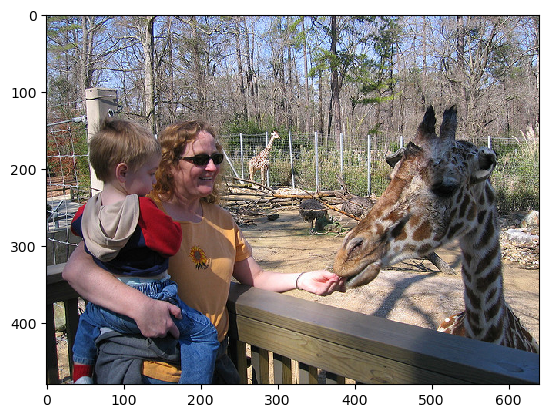

Annotation ids: [536921, 599129, 600124].

Annotation example: [{'segmentation': [[142.06, 238.92, 150.67, 217.4, 148.52, 195.87, 145.29, 173.27, 144.22, 172.2, 144.22, 152.83, 154.98, 129.15, 196.95, 132.38, 217.4, 146.37, 235.7, 162.51, 238.92, 200.18, 246.46, 228.16, 252.91, 258.3, 264.75, 303.5, 265.83, 303.5, 276.59, 316.41, 287.35, 330.4, 309.96, 330.4, 335.78, 327.17, 374.53, 330.4, 383.14, 337.94, 387.44, 346.55, 391.75, 362.69, 383.14, 363.77, 369.15, 368.07, 327.17, 369.15, 301.35, 361.61, 281.97, 359.46, 262.6, 357.31, 249.69, 359.46, 249.69, 380.99, 248.61, 412.2, 245.38, 439.1, 234.62, 474.4, 234.62, 473.33, 228.16, 429.2, 210.94, 399.07, 164.66, 356.02, 162.51, 315.12, 176.5, 301.13, 180.81, 274.22, 147.44, 240.86], [60.27, 473.33, 61.35, 453.96, 62.42, 443.19, 66.73, 432.43, 69.96, 425.97, 102.24, 422.74, 131.3, 424.9, 170.04, 428.13, 178.65, 449.65, 179.73, 475.48, 177.58, 475.48, 159.28, 473.33, 125.92, 472.25, 88.25, 474.4], [30.13, 471.39, 31.21, 445.56, 31.21, 420.8

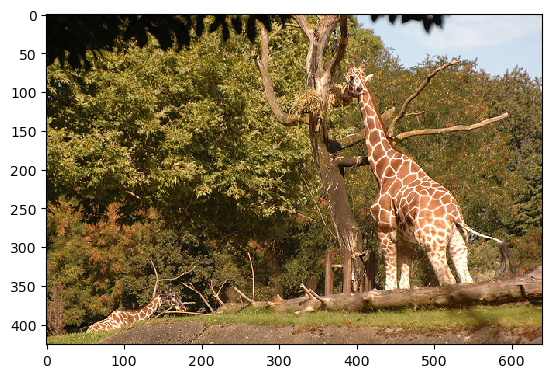

Annotation ids: [598548, 599491].

Annotation example: [{'segmentation': [[437.52, 353.33, 437.87, 326.98, 433.65, 306.26, 427.33, 287.29, 427.33, 279.56, 424.52, 266.21, 417.85, 255.68, 417.49, 248.65, 428.38, 234.95, 429.09, 223.71, 426.28, 211.77, 416.44, 192.45, 415.74, 191.05, 414.33, 182.27, 414.68, 180.51, 413.98, 170.32, 412.58, 168.22, 411.87, 165.41, 410.82, 149.6, 405.9, 121.15, 400.28, 107.45, 392.56, 108.85, 386.58, 101.13, 385.88, 99.72, 385.53, 92.7, 386.58, 88.48, 385.88, 84.62, 386.94, 81.1, 392.91, 68.11, 395.01, 60.03, 396.07, 60.03, 398.88, 65.65, 398.53, 68.46, 399.58, 70.57, 404.5, 68.81, 408.01, 61.79, 408.71, 61.08, 413.28, 62.84, 409.77, 73.38, 409.77, 77.24, 414.33, 81.81, 418.55, 80.75, 424.17, 77.59, 424.52, 80.4, 418.9, 86.72, 413.98, 93.05, 432.25, 127.82, 442.78, 157.68, 453.32, 172.43, 465.62, 179.46, 482.48, 198.42, 497.23, 214.23, 519.71, 226.17, 535.87, 251.81, 542.19, 268.67, 543.59, 272.89, 562.21, 285.18, 590.31, 293.96, 599.44, 297.12, 600.5, 321.

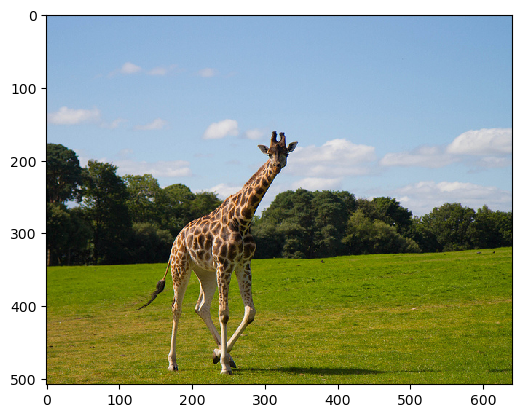

Annotation ids: [595318].

Annotation example: [{'segmentation': [[170.09, 484.31, 164.9, 456.29, 171.13, 346.28, 162.83, 379.49, 122.35, 412.7, 158.68, 351.47, 186.7, 287.13, 226.13, 265.34, 262.46, 238.35, 305.01, 197.88, 289.45, 180.23, 302.93, 177.12, 314.34, 155.32, 328.88, 163.63, 335.11, 176.09, 348.59, 171.93, 350.67, 180.23, 326.8, 211.36, 306.04, 231.09, 283.21, 281.93, 291.51, 322.41, 280.1, 340.05, 291.51, 424.12, 255.2, 458.36, 261.42, 483.27, 247.93, 494.69, 234.43, 490.53, 225.1, 466.66, 232.37, 447.99, 206.42, 402.32, 207.46, 357.7, 189.81, 385.71, 182.55, 491.57, 171.13, 491.57]], 'area': 25402.263250000004, 'iscrowd': 0, 'image_id': 376858, 'bbox': [122.35, 155.32, 228.32, 339.37], 'category_id': 25, 'id': 595318}]


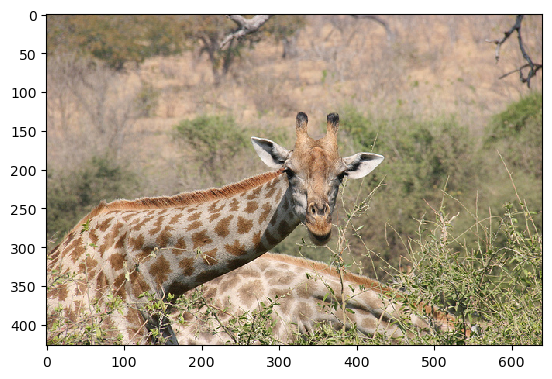

Annotation ids: [596315, 596656].

Annotation example: [{'segmentation': [[0.0, 312.46, 69.73, 241.77, 139.47, 235.09, 255.05, 213.11, 299.0, 205.47, 271.29, 193.05, 263.65, 162.49, 281.8, 160.58, 318.1, 173.95, 319.06, 140.52, 321.92, 131.92, 334.34, 123.32, 340.07, 147.2, 343.89, 161.53, 359.18, 165.35, 360.13, 133.83, 363.0, 126.19, 381.15, 127.14, 379.24, 172.04, 382.1, 183.5, 405.03, 176.81, 439.42, 184.46, 424.13, 204.52, 393.57, 216.94, 388.79, 216.94, 374.46, 237.0, 364.91, 282.85, 363.95, 299.09, 348.67, 301.0, 328.61, 274.25, 298.04, 300.04, 231.17, 334.43, 169.08, 363.09, 158.57, 380.28, 170.99, 418.49, 0.0, 421.36]], 'area': 56670.0072, 'iscrowd': 0, 'image_id': 65564, 'bbox': [0.0, 123.32, 439.42, 298.04], 'category_id': 25, 'id': 596315}, {'segmentation': [[175.25, 362.85, 291.27, 305.28, 416.01, 334.94, 539.88, 395.13, 571.28, 412.58, 509.35, 427.0, 449.16, 423.05, 361.92, 402.98, 320.92, 427.0, 170.89, 427.0, 172.63, 423.05, 160.42, 382.05, 171.76, 361.12]], 'area': 308

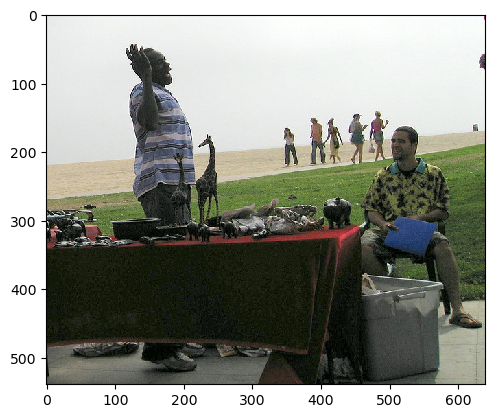

Annotation ids: [459394, 484417, 497842, 538179, 540972, 541287, 541834, 595539, 710584, 1177136, 1180078, 1433628, 1937645].

Annotation example: [{'segmentation': [[467.83, 380.59, 463.5, 379.35, 461.02, 365.72, 461.02, 352.7, 459.16, 343.4, 459.16, 335.34, 465.35, 316.13, 474.03, 313.65, 480.85, 308.07, 476.51, 304.35, 472.79, 298.15, 469.07, 290.09, 468.45, 288.86, 459.78, 281.42, 463.5, 264.06, 467.21, 256.62, 471.55, 252.28, 474.03, 246.08, 483.33, 232.45, 489.53, 224.39, 496.97, 221.29, 504.41, 218.19, 509.36, 215.09, 506.89, 213.23, 505.03, 202.69, 503.17, 190.92, 503.79, 187.2, 502.55, 182.24, 506.27, 175.42, 510.6, 168.6, 513.08, 164.26, 521.14, 163.02, 524.24, 162.4, 531.68, 165.5, 538.5, 169.22, 540.36, 173.56, 542.22, 182.24, 541.6, 196.5, 539.74, 204.55, 541.6, 210.75, 547.8, 207.03, 554.61, 216.33, 555.85, 216.95, 573.21, 224.39, 580.65, 229.97, 581.89, 239.89, 585.61, 253.52, 587.47, 260.34, 591.19, 269.02, 584.82, 301.57, 570.35, 301.57, 571.56, 324.48, 587.23, 328.1, 

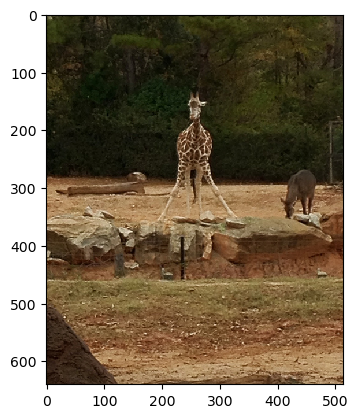

Annotation ids: [598868].

Annotation example: [{'segmentation': [[190.2, 358.41, 219.56, 298.88, 229.09, 254.43, 225.12, 213.95, 249.73, 188.55, 249.73, 174.27, 244.97, 156.01, 248.93, 144.1, 250.52, 130.61, 256.87, 143.31, 261.64, 132.19, 267.99, 152.83, 281.48, 152.83, 269.57, 166.32, 269.57, 187.76, 288.63, 216.33, 284.65, 255.22, 295.77, 295.71, 321.96, 335.39, 331.49, 355.24, 317.2, 351.27, 291.8, 313.97, 271.16, 280.62, 271.16, 344.92, 264.01, 345.72, 256.87, 281.42, 248.93, 279.83, 250.52, 352.06, 241.0, 348.1, 238.61, 286.19, 202.89, 359.2, 194.16, 356.04]], 'area': 9761.681349999999, 'iscrowd': 0, 'image_id': 196650, 'bbox': [190.2, 130.61, 141.29, 228.59], 'category_id': 25, 'id': 598868}]


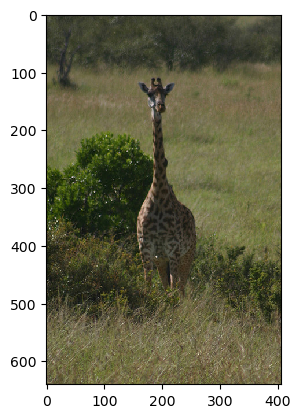

Annotation ids: [595640].

Annotation example: [{'segmentation': [[178.64, 438.61, 177.37, 499.54, 167.21, 494.46, 163.41, 439.88, 155.79, 353.55, 181.18, 293.88, 181.18, 179.63, 172.29, 149.16, 155.79, 113.61, 178.64, 126.31, 181.18, 106.0, 196.41, 106.0, 202.76, 127.58, 221.8, 117.42, 210.38, 144.08, 201.49, 185.97, 209.11, 249.45, 215.46, 296.42, 240.85, 334.51, 261.16, 368.78, 249.73, 441.15, 242.12, 472.88, 237.04, 509.7, 219.26, 504.62, 198.95, 472.88, 188.8, 441.15]], 'area': 21199.814700000003, 'iscrowd': 0, 'image_id': 524331, 'bbox': [155.79, 106.0, 105.37, 403.7], 'category_id': 25, 'id': 595640}]


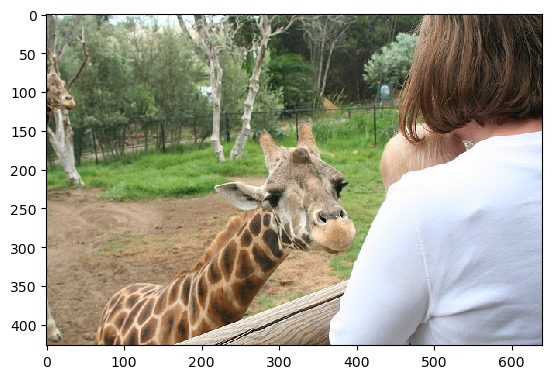

Annotation ids: [458938, 594851, 1413824, 2162709].

Annotation example: [{'segmentation': [[417.38, 283.22, 427.96, 249.56, 448.16, 219.75, 470.28, 208.21, 513.55, 193.78, 552.98, 170.7, 523.17, 156.28, 508.75, 153.39, 489.51, 129.35, 481.82, 127.43, 477.97, 135.12, 478.93, 146.66, 479.89, 154.35, 482.78, 159.16, 477.97, 164.93, 464.51, 148.58, 461.62, 107.23, 491.43, 4.33, 638.58, 3.37, 635.69, 153.39, 636.65, 415.94, 362.57, 420.75, 366.41, 401.51, 371.22, 392.86, 379.88, 370.74, 388.53, 351.51, 405.84, 306.31, 419.31, 282.26]], 'area': 79023.6626, 'iscrowd': 0, 'image_id': 368686, 'bbox': [362.57, 3.37, 276.01, 417.38], 'category_id': 1, 'id': 458938}, {'segmentation': [[62.23, 415.51, 79.46, 369.56, 105.31, 349.45, 134.99, 344.66, 154.14, 347.54, 177.12, 329.35, 195.31, 317.86, 245.09, 257.54, 214.46, 224.99, 245.09, 214.46, 281.48, 222.12, 287.22, 207.76, 281.48, 181.91, 264.24, 156.06, 287.22, 147.44, 298.71, 164.67, 321.69, 170.42, 330.3, 140.74, 342.75, 144.57, 351.37, 169.46,

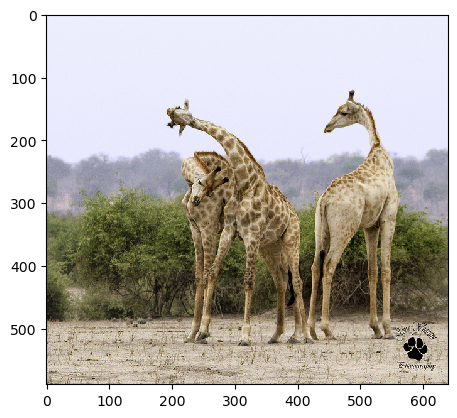

Annotation ids: [598715, 599009, 600496].

Annotation example: [{'segmentation': [[505.24, 170.85, 511.88, 180.16, 517.2, 188.13, 518.53, 217.38, 502.58, 243.98, 486.62, 257.27, 457.37, 265.25, 445.41, 277.22, 429.45, 311.78, 426.79, 343.69, 426.79, 370.29, 422.8, 403.52, 420.14, 423.47, 420.14, 450.06, 418.81, 471.33, 416.16, 487.29, 417.49, 497.92, 420.14, 504.57, 420.14, 517.87, 425.46, 517.87, 432.11, 519.2, 432.11, 512.55, 430.78, 487.29, 430.78, 450.06, 438.76, 420.81, 442.75, 440.75, 436.1, 499.25, 449.4, 517.87, 460.03, 517.87, 456.04, 513.88, 445.41, 493.94, 446.74, 458.04, 453.38, 426.13, 456.04, 411.5, 472.0, 384.91, 477.32, 366.3, 486.62, 345.02, 499.92, 337.05, 513.21, 398.21, 517.2, 460.7, 517.2, 496.59, 518.53, 512.55, 525.18, 519.2, 531.83, 513.88, 531.83, 503.24, 523.85, 489.95, 529.17, 446.07, 531.83, 410.17, 531.83, 371.62, 535.82, 366.3, 531.83, 450.06, 531.83, 493.94, 539.81, 513.88, 549.11, 516.54, 557.09, 516.54, 555.76, 499.25, 550.44, 477.98, 550.44, 394.22, 55

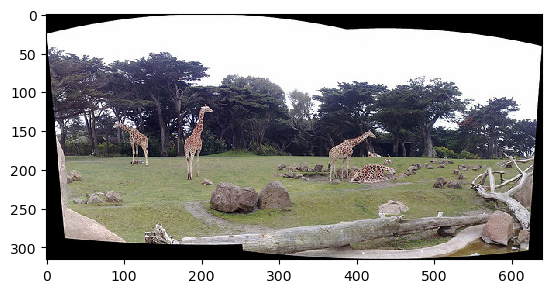

Annotation ids: [598111, 599997, 600019, 601581, 1414081].

Annotation example: [{'segmentation': [[365.16, 214.51, 363.7, 198.08, 366.62, 179.1, 371.37, 170.34, 381.95, 166.69, 387.79, 161.94, 403.49, 160.85, 411.89, 152.82, 417.36, 150.26, 427.22, 160.12, 415.9, 157.93, 403.86, 167.78, 395.46, 172.53, 395.46, 178.73, 394.0, 185.67, 390.71, 209.03, 391.81, 214.87, 388.16, 213.78, 389.25, 199.18, 390.35, 184.94, 387.43, 186.4, 383.41, 202.83, 383.78, 214.87, 382.32, 215.24, 381.95, 209.76, 382.68, 189.68, 384.14, 186.03, 376.11, 185.67, 372.83, 195.89, 377.57, 211.59, 374.65, 212.68, 371.37, 200.27, 369.91, 200.64, 367.35, 215.24]], 'area': 1150.4527000000003, 'iscrowd': 0, 'image_id': 352305, 'bbox': [363.7, 150.26, 63.52, 64.98], 'category_id': 25, 'id': 598111}, {'segmentation': [[182.41, 213.72, 180.07, 188.42, 175.38, 169.22, 179.6, 162.19, 190.37, 153.29, 189.91, 147.2, 194.59, 143.92, 196.0, 132.67, 201.15, 121.43, 203.02, 118.62, 205.84, 115.34, 210.99, 120.02, 217.08, 125.18, 

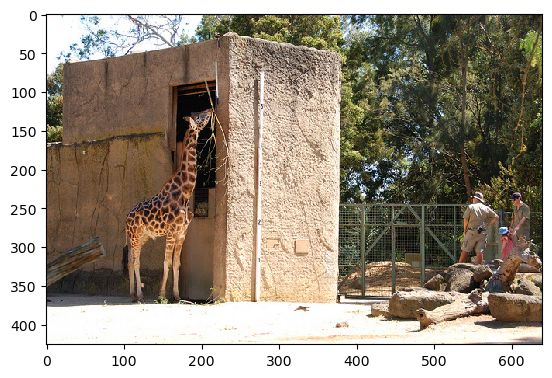

Annotation ids: [461370, 478748, 505699, 594476].

Annotation example: [{'segmentation': [[531.53, 319.22, 535.88, 305.86, 534.32, 295.6, 539.3, 283.17, 538.99, 270.12, 536.81, 262.97, 537.12, 258.94, 542.09, 247.44, 546.13, 244.95, 546.44, 236.56, 551.1, 232.21, 555.46, 229.72, 558.56, 230.04, 562.91, 232.52, 566.64, 239.36, 568.2, 245.26, 570.99, 248.06, 578.14, 251.79, 582.8, 255.83, 584.98, 261.42, 584.67, 266.39, 574.72, 275.09, 571.61, 279.44, 570.68, 285.35, 566.64, 301.2, 564.47, 310.83, 564.47, 323.88, 557.94, 324.19, 555.46, 322.02, 554.21, 314.87, 552.04, 307.1, 546.44, 309.28, 542.4, 319.84, 540.23, 323.57, 535.88, 322.95]], 'area': 2866.3770499999987, 'iscrowd': 0, 'image_id': 548915, 'bbox': [531.53, 229.72, 53.45, 94.47], 'category_id': 1, 'id': 461370}, {'segmentation': [[624.59, 289.69, 625.24, 280.6, 625.24, 272.81, 624.59, 263.71, 624.59, 258.84, 623.62, 252.03, 622.0, 249.1, 618.43, 246.51, 614.85, 244.23, 612.91, 239.69, 612.58, 237.09, 612.91, 233.84, 609.01, 231.

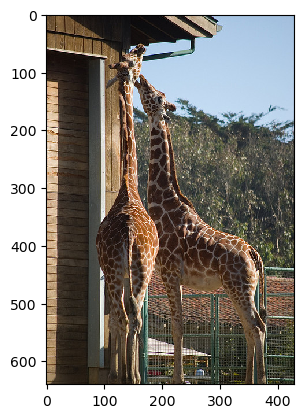

Annotation ids: [594886, 597929, 1713870].

Annotation example: [{'segmentation': [[178.34, 189.6, 152.45, 122.01, 166.83, 99.0, 191.28, 127.76, 212.85, 142.14, 222.92, 169.47, 218.61, 189.6, 215.73, 198.23, 227.24, 296.03, 260.31, 352.12, 326.47, 382.32, 371.06, 409.65, 379.69, 472.93, 386.88, 537.65, 376.81, 572.16, 381.12, 628.25, 343.73, 618.19, 349.48, 562.1, 326.47, 508.88, 297.71, 478.68, 237.3, 471.49, 241.62, 575.04, 241.62, 634.01, 215.73, 628.25, 215.73, 543.4, 204.22, 470.05, 186.97, 432.66, 197.03, 378.01, 171.15, 323.36, 178.34, 238.5]], 'area': 42378.185850000016, 'iscrowd': 0, 'image_id': 385075, 'bbox': [152.45, 99.0, 234.43, 535.01], 'category_id': 25, 'id': 594886}, {'segmentation': [[108.38, 623.49, 103.16, 471.82, 84.85, 418.21, 91.4, 360.69, 130.62, 287.47, 126.69, 190.72, 121.46, 120.12, 105.78, 129.27, 113.62, 97.88, 107.07, 87.43, 129.31, 75.66, 163.31, 48.21, 173.76, 57.36, 160.69, 109.66, 148.93, 126.65, 160.69, 286.16, 185.53, 352.85, 194.68, 385.52, 188.15,

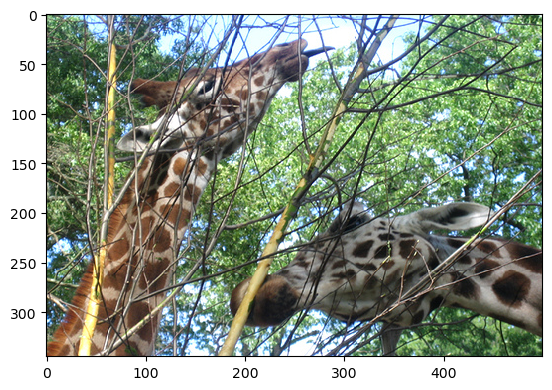

Annotation ids: [598173, 599181].

Annotation example: [{'segmentation': [[498.23, 326.3, 411.53, 298.82, 389.69, 309.38, 360.78, 317.84, 327.66, 312.91, 298.06, 315.03, 260.7, 300.23, 239.56, 314.32, 205.02, 317.14, 185.29, 299.52, 189.52, 274.85, 199.39, 265.69, 239.56, 253.71, 276.91, 214.24, 312.86, 178.29, 334.71, 204.37, 379.11, 192.39, 431.97, 186.75, 459.46, 200.84, 431.27, 221.29, 390.39, 225.51, 466.51, 223.4, 500.0, 239.61, 500.0, 329.83]], 'area': 29901.85415, 'iscrowd': 0, 'image_id': 254003, 'bbox': [185.29, 178.29, 314.71, 151.54], 'category_id': 25, 'id': 598173}, {'segmentation': [[1.55, 342.67, 14.73, 315.54, 34.11, 270.57, 58.15, 223.28, 69.78, 191.49, 88.38, 160.48, 100.01, 144.2, 93.81, 137.22, 82.18, 139.55, 70.55, 133.35, 78.3, 124.04, 90.71, 113.97, 100.01, 113.97, 112.42, 104.66, 110.87, 93.03, 96.91, 95.36, 91.48, 97.69, 91.48, 89.93, 91.48, 84.51, 85.28, 80.63, 88.38, 66.67, 98.46, 64.35, 130.25, 69.78, 147.3, 55.04, 173.66, 54.27, 206.22, 43.42, 223.28, 37.2

In [37]:
# Display some giraffe images with their assoicated annotation data: 
for index in range(20):
    show_image(giraffe_image_ids_list[index])
    annotation_id = coco_api.getAnnIds(imgIds=giraffe_image_ids_list[index])
    print(f"Annotation ids: {annotation_id}.")
    annotation_example = coco_api.loadAnns(annotation_id)
    print(f"\nAnnotation example: {annotation_example}")

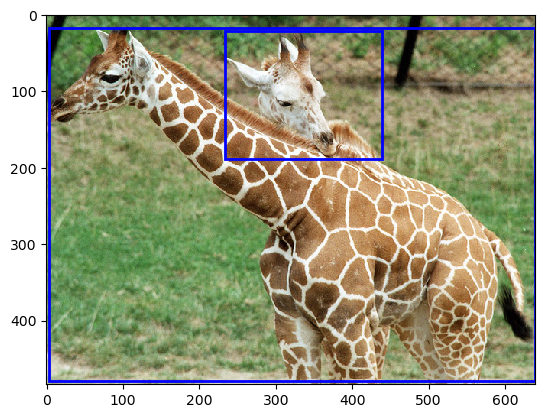

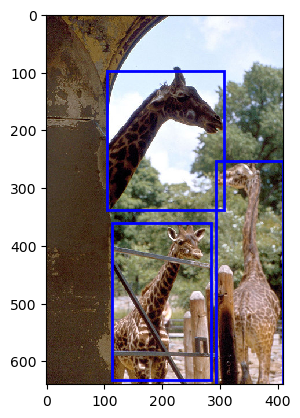

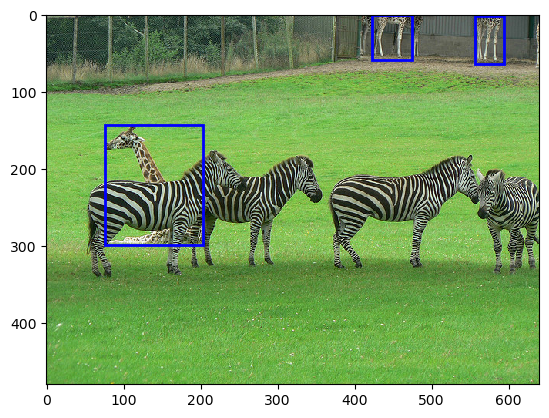

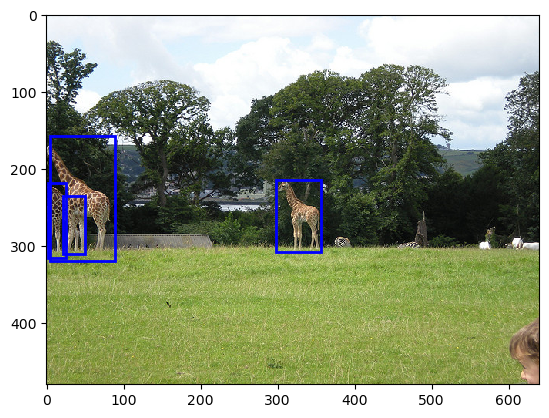

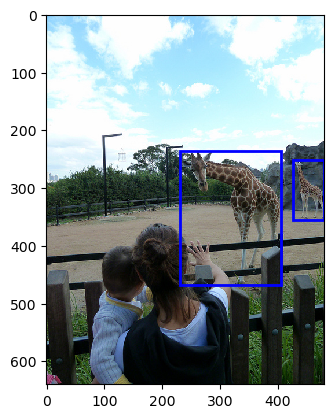

...

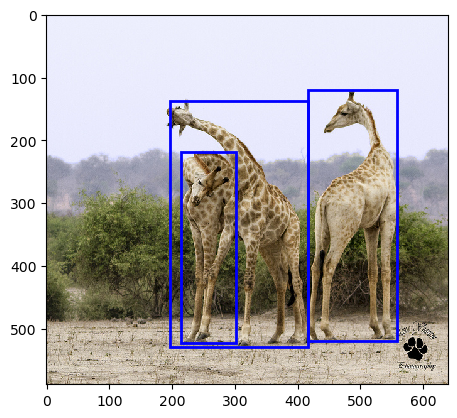

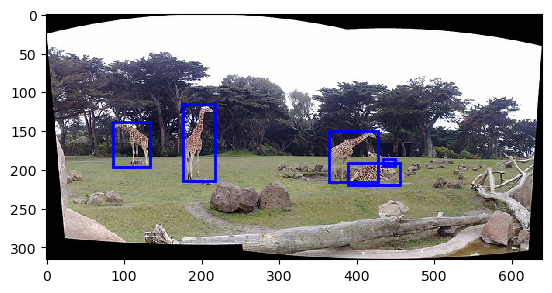

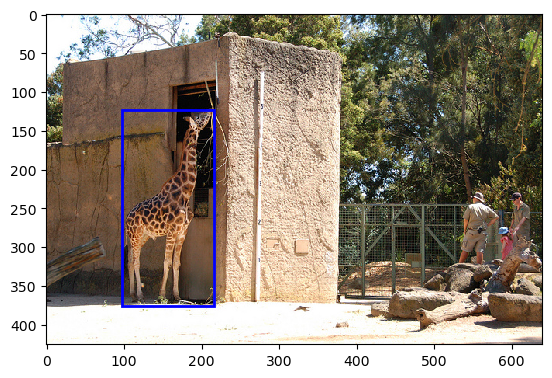

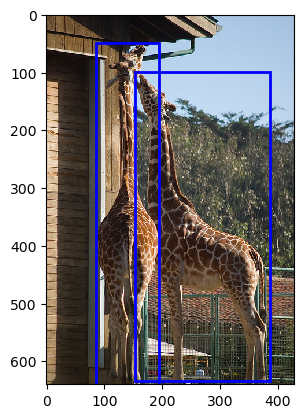

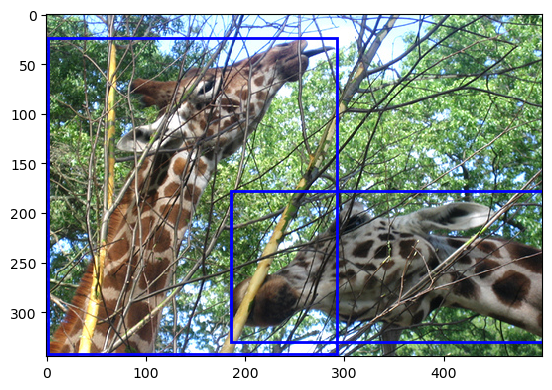

In [38]:
# Checking bounding boxes for giraffes:
for index in range(20):
    annotation_id = coco_api.getAnnIds(imgIds=giraffe_image_ids_list[index])
    show_image(giraffe_image_ids_list[index], annotation_object=coco_api.loadAnns(annotation_id), 
               giraffe_only=True)